In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.insert(0, '/lab/solexa_weissman/kmin/git/spateo-release')

import anndata
import matplotlib.pyplot as plt
import numpy as np
import skimage
import sklearn
import spateo as st

plt.style.use('default')
plt.rcParams['image.interpolation'] = 'none'
%config InlineBackend.figure_format='retina'

/home/kmin/miniconda3/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/home/kmin/miniconda3/lib/python3.8/site-packages/spaghetti/network.py:36: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(f"{dep_msg}", FutureWarning)


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


2022-03-28 15:49:43.682984: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/nfs/lsf8/8.0/linux2.6-glibc2.3-x86_64/lib


In [57]:
%%time
adata = st.io.read_bgi_agg(
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/zehua/matrix.txt.gz',
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/zehua/E16.5_E1S3.tif',
    scale=0.5,
    scale_unit='um',
    gene_agg={'nuclear': ['Malat1']}
)[2500*2:17000*2,4000*2:].copy()
adata

CPU times: user 5min 46s, sys: 24.8 s, total: 6min 10s
Wall time: 5min 58s


AnnData object with n_obs × n_vars = 29000 × 18461
    uns: '__type', 'pp', 'spatial'
    layers: 'stain', 'spliced', 'unspliced', 'nuclear'

In [70]:
st.pp.segmentation.select_qc_regions(adata, seed=0)
adata.uns['spatial']['qc']

array([[15000, 17000, 12000, 14000],
       [19000, 21000, 16000, 18000],
       [17000, 19000, 22000, 24000],
       [21000, 23000, 18000, 20000]])

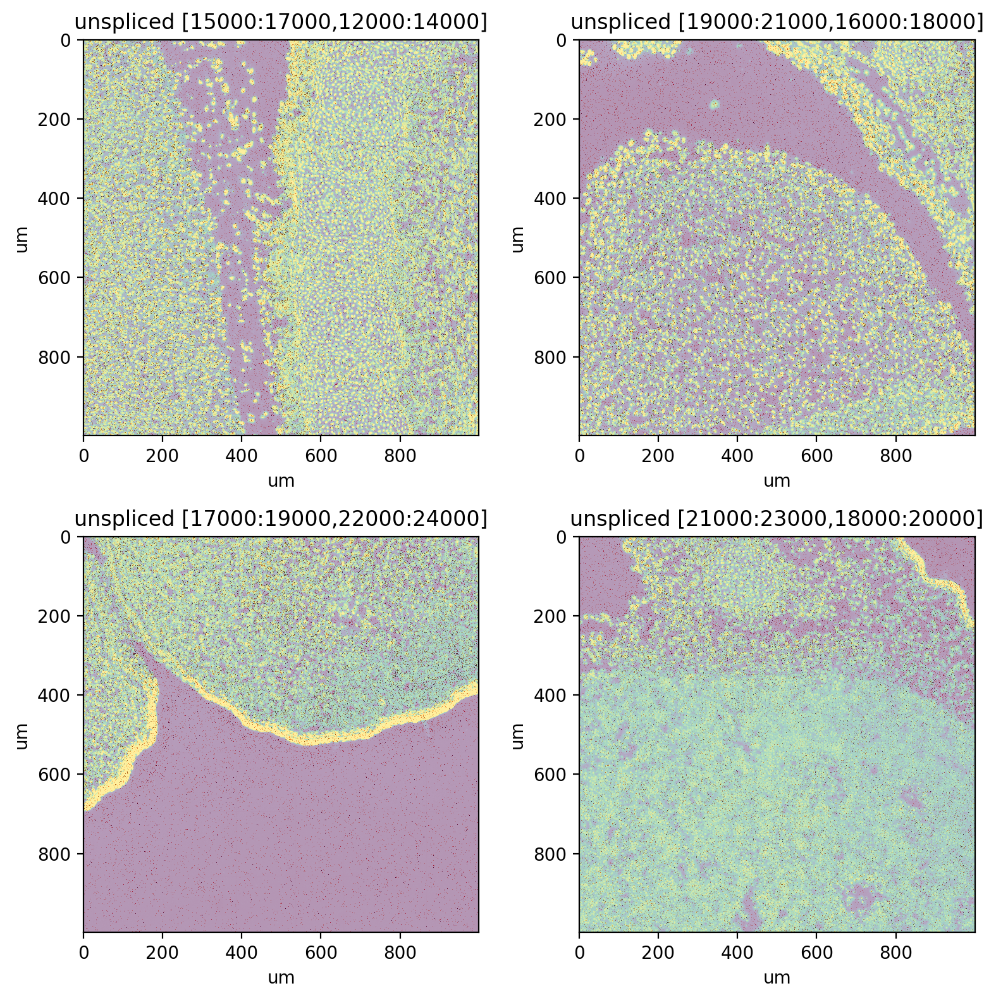

In [60]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'unspliced', axes=axes, vmax=3, alpha=0.6, cmap='Reds')

In [4]:
before = adata.layers['stain'].copy()
st.pp.segmentation.refine_alignment(adata, mode='non-rigid', transform_layers=['stain'], downscale=0.2, meshsize=1000)

Loss -1.3298e-02: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [11:34<00:00,  6.95s/it]


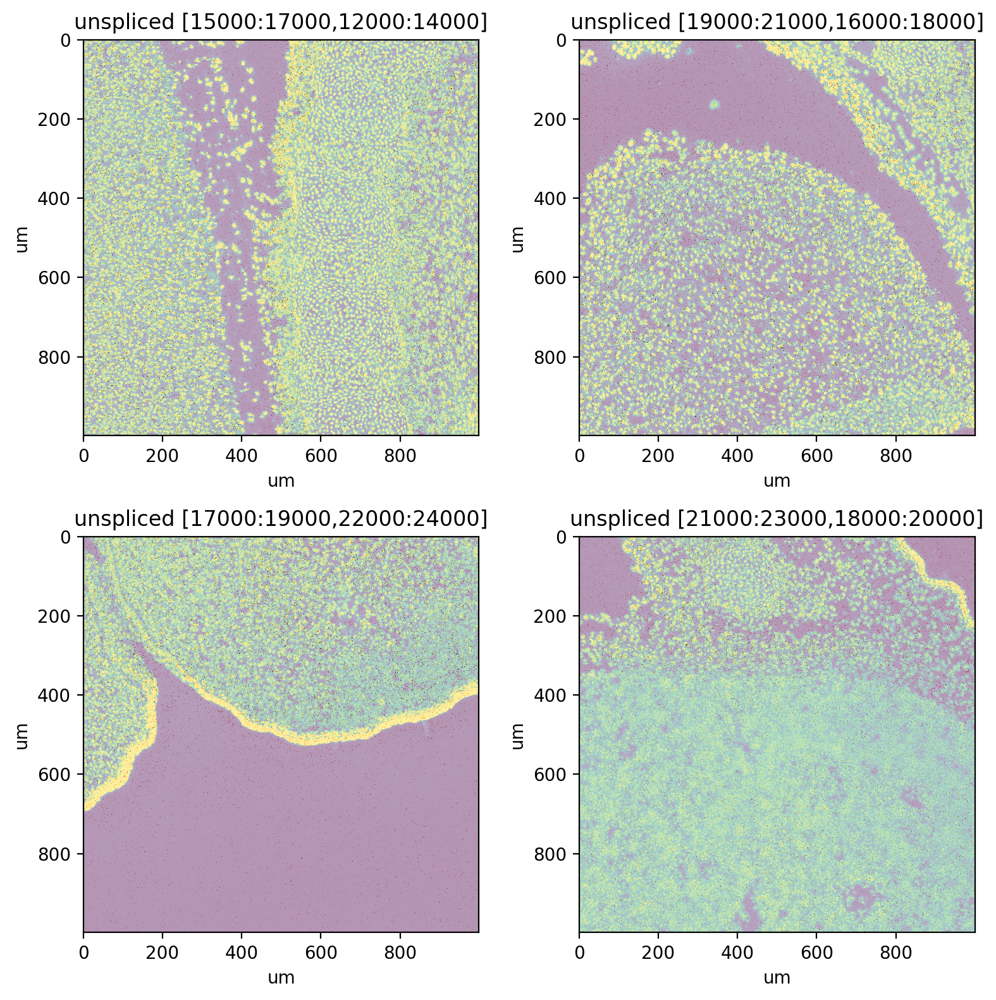

In [56]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'unspliced', axes=axes, vmax=5, alpha=0.6, cmap='Reds')

In [151]:
%%time
st.pp.segmentation.mask_nuclei_from_stain(adata)
st.pp.segmentation.watershed_markers(adata)
st.pp.segmentation.watershed(adata)

CPU times: user 8min 46s, sys: 45.9 s, total: 9min 32s
Wall time: 5min 26s


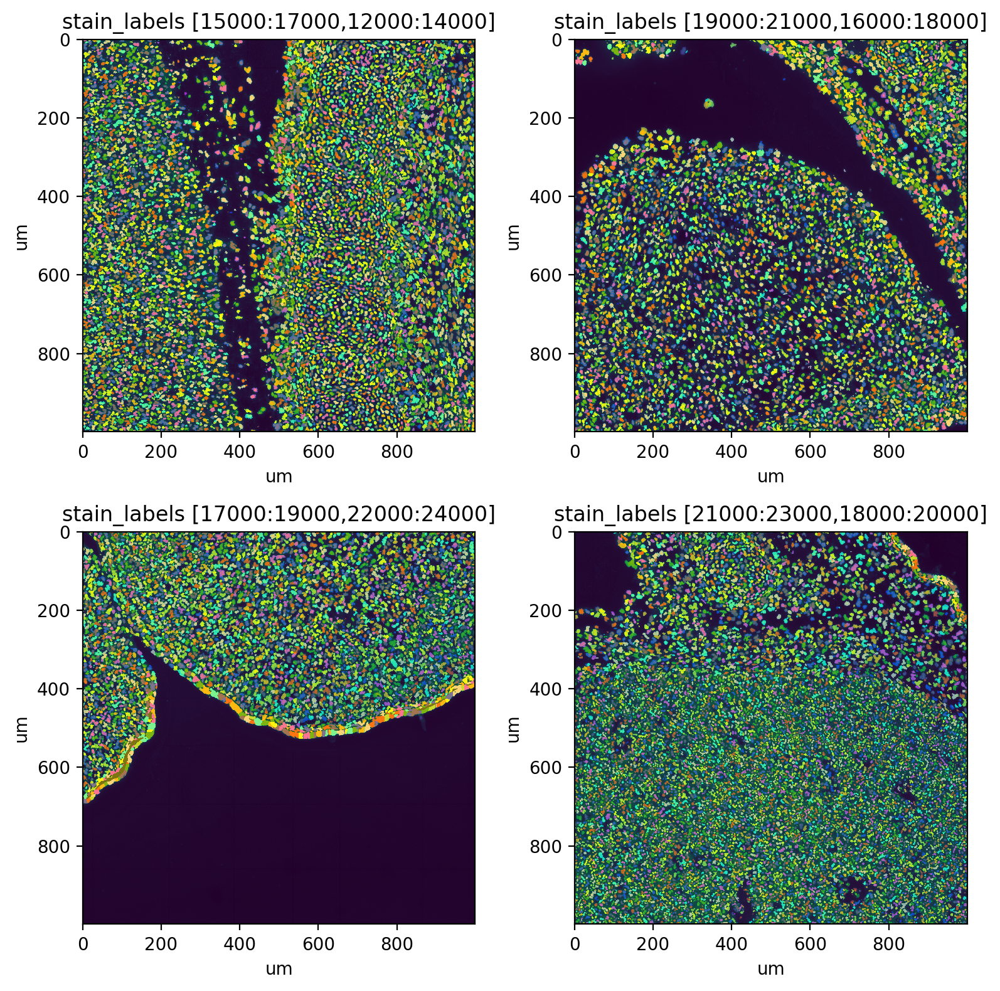

In [152]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'stain_labels', axes=axes, alpha=0.5, labels=True)

In [153]:
%%time
st.pp.segmentation.mask_cells_from_stain(adata, out_layer='stain_cell_mask')
st.pp.segmentation.watershed(
    adata,
    mask_layer='stain_cell_mask',
    markers_layer='stain_labels',
    out_layer='cell_labels',
)

CPU times: user 14min 20s, sys: 14.8 s, total: 14min 35s
Wall time: 14min 29s


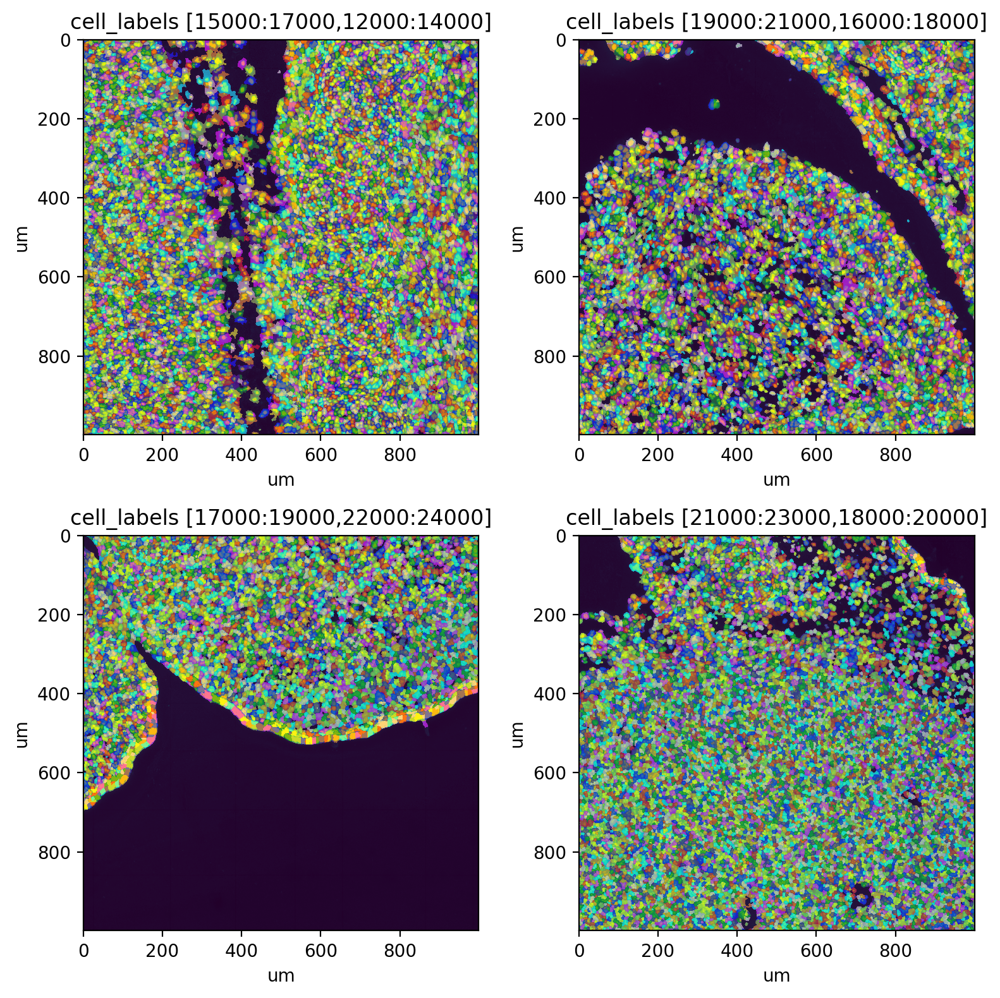

In [154]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'cell_labels', axes=axes, alpha=0.5, labels=True)

In [155]:
%%time
# There seems to be more diffusion in this tissue.
st.pp.segmentation.expand_labels(adata, 'cell_labels', distance=3, max_area=np.inf, out_layer='cell_labels_expanded')

CPU times: user 17min 26s, sys: 12.6 s, total: 17min 39s
Wall time: 17min 24s


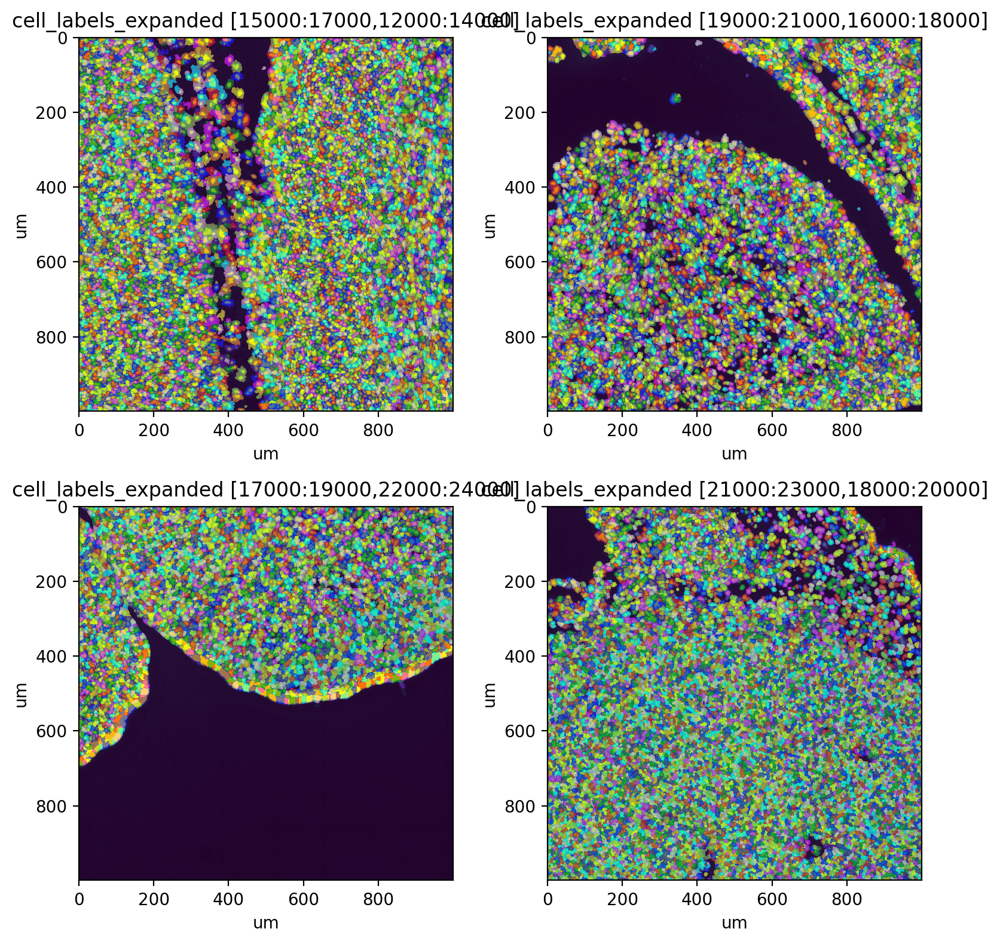

In [156]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'cell_labels_expanded', axes=axes, alpha=0.5, labels=True)

In [157]:
adata.write('data/E16.5_E1S3.h5ad', compression='gzip')

IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


In [77]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'nuclear', k=13, method='EM+BP',
    em_kwargs=dict(downsample=0.001), bp_kwargs=dict(n_threads=16),
    mk=3  # Expected to be small
)
st.pp.segmentation.label_connected_components(adata, 'nuclear')

Running EM: 100%|#########################################################################| 1/1 [01:29<00:00, 89.89s/it]


CPU times: user 25min 50s, sys: 3min 28s, total: 29min 18s
Wall time: 15min 14s


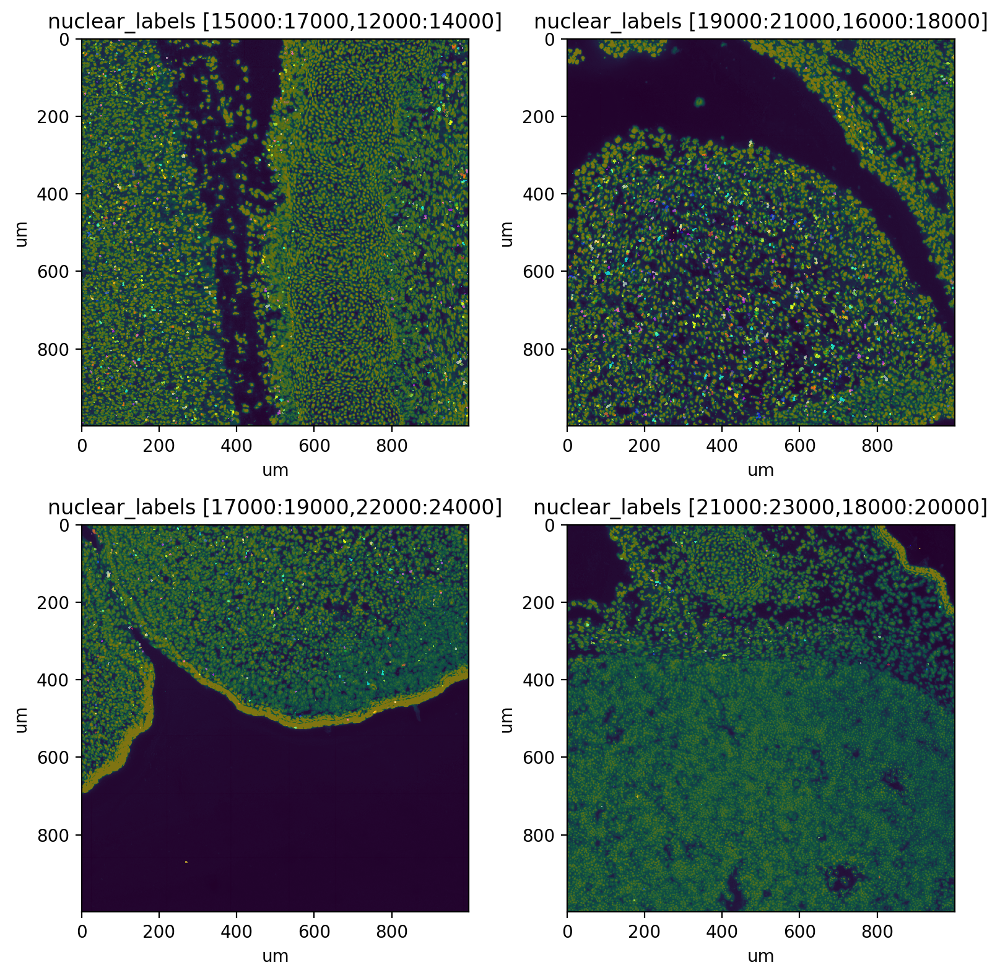

In [78]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'nuclear_labels', axes=axes, alpha=0.5, labels=True)

CPU times: user 1min 41s, sys: 19.9 s, total: 2min 1s
Wall time: 1min 56s


(<Figure size 400x400 with 1 Axes>,
 <AxesSubplot:title={'center':'unspliced_bins'}, xlabel='um', ylabel='um'>)

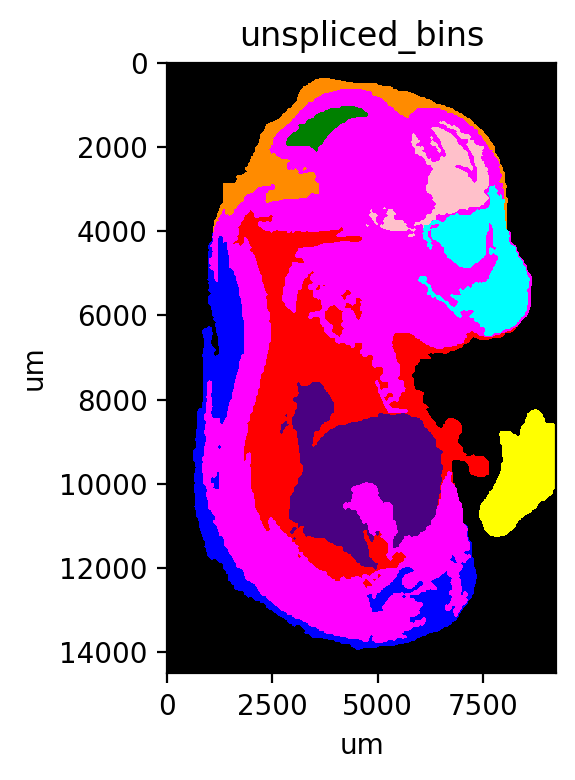

In [79]:
%%time
st.pp.segmentation.segment_densities(adata, 'unspliced', 40, k=3, dk=3, distance_threshold=10)
st.pl.imshow(adata, 'unspliced_bins', labels=True)

In [138]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'unspliced', k=13, method='EM+BP',
    em_kwargs=dict(downsample=0.001, n_threads=16), bp_kwargs=dict(n_threads=16),
    certain_layer='nuclear_labels'
)
st.pp.segmentation.label_connected_components(adata, 'unspliced', seed_layer='nuclear_labels')

Running EM:   0%|                                                                                 | 0/9 [00:00<?, ?it/s]2022-03-16 11:00:20.481456: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/nfs/lsf8/8.0/linux2.6-glibc2.3-x86_64/lib
2022-03-16 11:00:20.481490: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-03-16 11:00:20.481557: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/

CPU times: user 1h 14min 12s, sys: 3min 11s, total: 1h 17min 23s
Wall time: 50min 23s


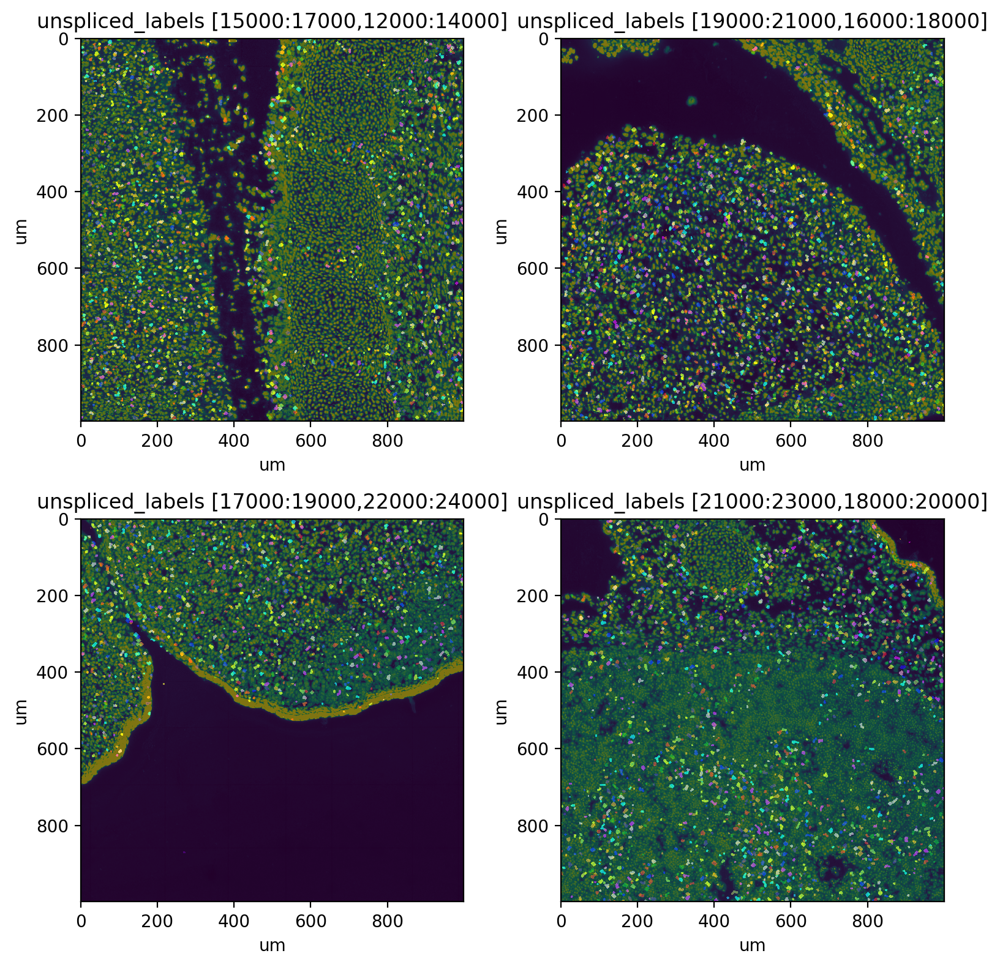

In [141]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'unspliced_labels', axes=axes, alpha=0.5, labels=True)

CPU times: user 5min 44s, sys: 23.8 s, total: 6min 7s
Wall time: 6min


(<Figure size 400x400 with 1 Axes>,
 <AxesSubplot:title={'center':'X_bins'}, xlabel='um', ylabel='um'>)

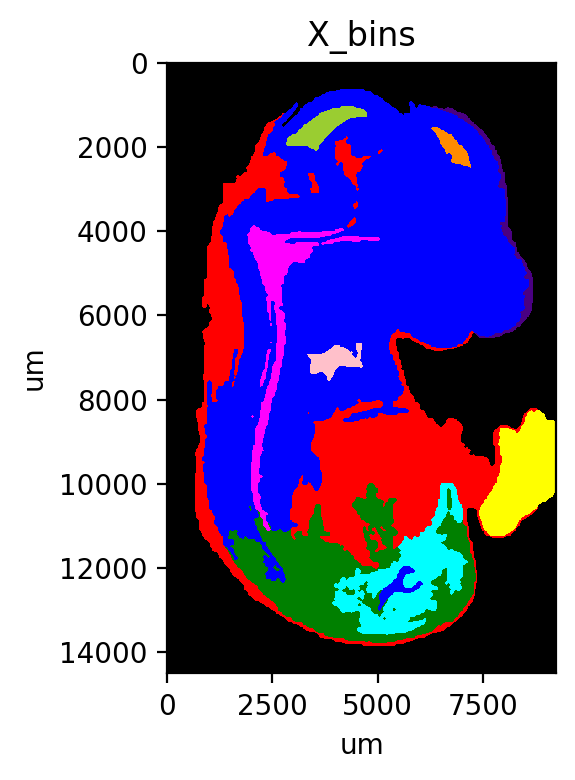

In [142]:
%%time
st.pp.segmentation.segment_densities(adata, 'X', 40, k=3, dk=3, distance_threshold=8)
st.pp.segmentation.merge_densities(adata, 'X', {7: 0, 11: 3})
st.pl.imshow(adata, 'X_bins', labels=True)

In [143]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'X', k=15, method='EM+BP',
    em_kwargs=dict(downsample=0.001, n_threads=16), bp_kwargs=dict(n_threads=16),
    certain_layer='unspliced_labels'
)
st.pp.segmentation.expand_labels(
    adata, 'unspliced', distance=5, max_area=400, mask_layer='X_mask', out_layer='X_labels'
)

Running EM:   0%|                                                                                | 0/12 [00:00<?, ?it/s]2022-03-16 12:41:45.221045: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/nfs/lsf8/8.0/linux2.6-glibc2.3-x86_64/lib
2022-03-16 12:41:45.221079: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-03-16 12:41:48.707761: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/

CPU times: user 2h 10min 34s, sys: 7min 9s, total: 2h 17min 43s
Wall time: 2h 31s


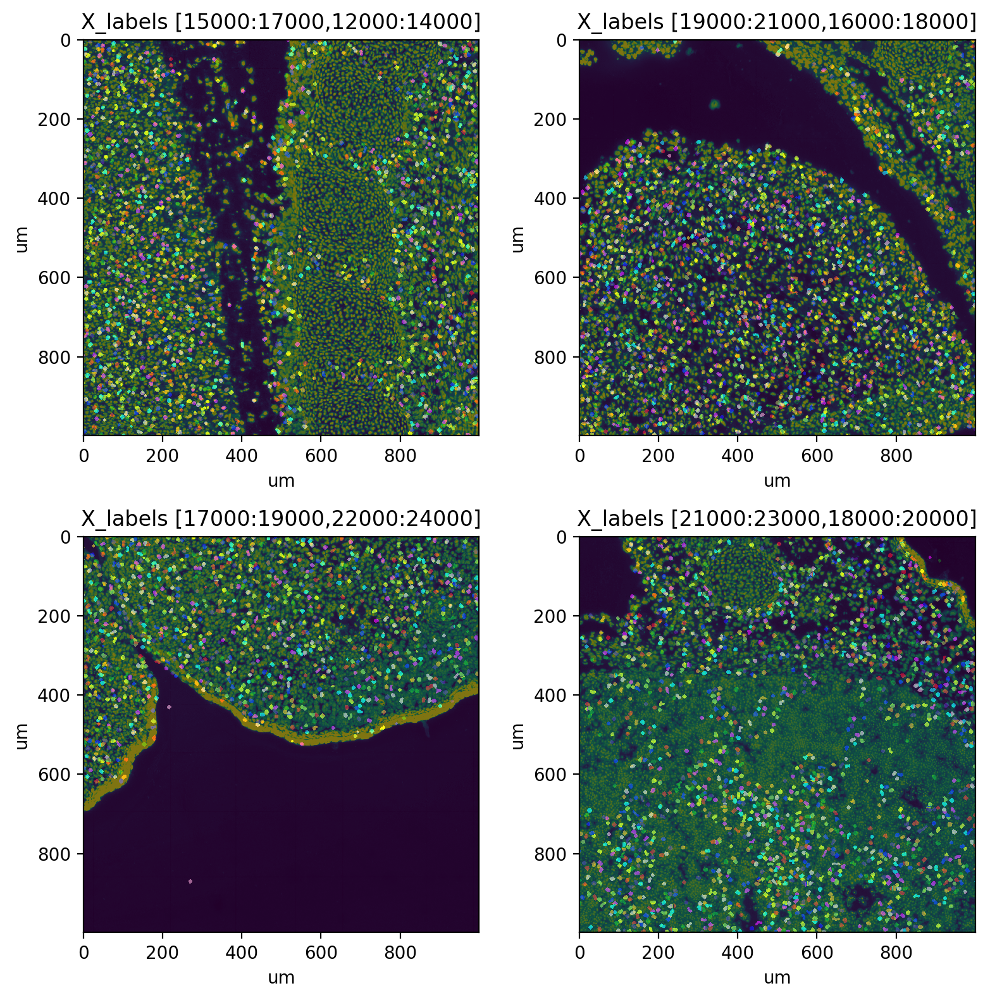

In [144]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'X_labels', axes=axes, alpha=0.5, labels=True)

In [145]:
%%time
st.pp.segmentation.expand_labels(adata, 'X', distance=2, max_area=np.inf, out_layer='X_labels_expanded')

CPU times: user 20min 52s, sys: 19.5 s, total: 21min 12s
Wall time: 20min 54s


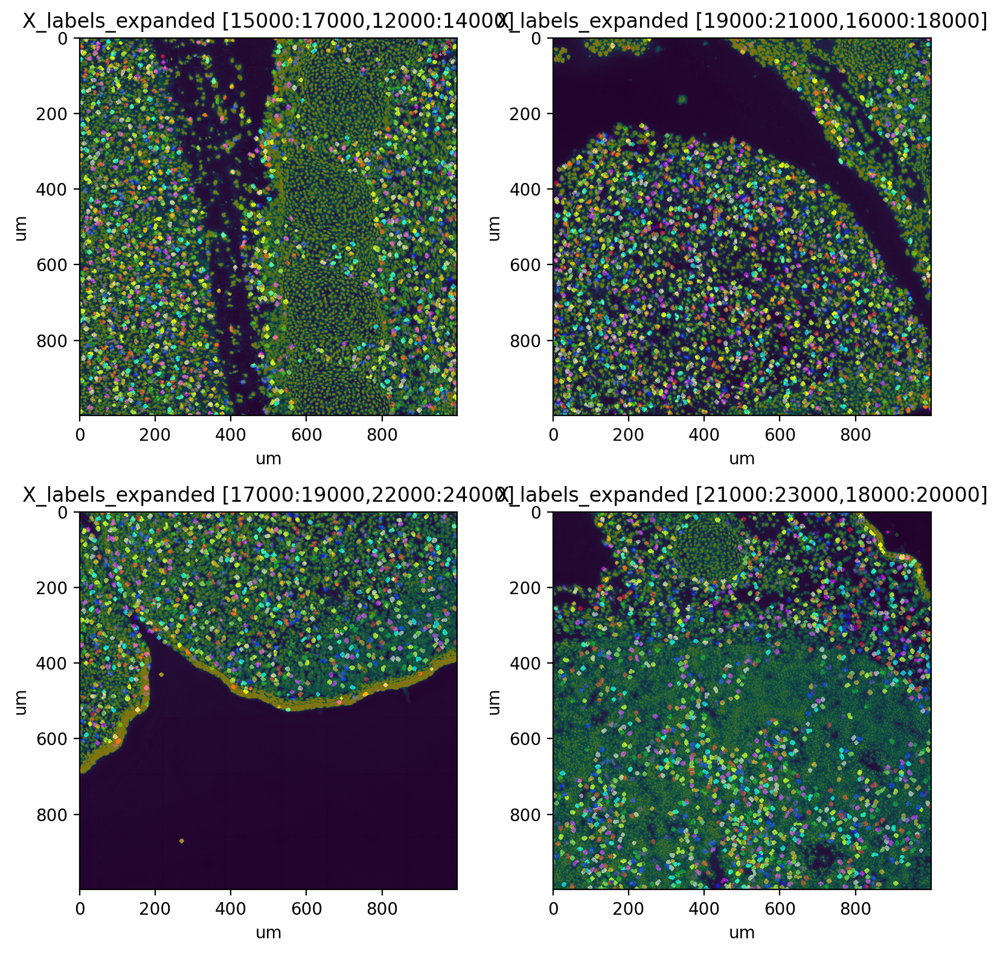

In [146]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'X_labels_expanded', axes=axes, alpha=0.5, labels=True)

In [159]:
bgi_adata = st.io.read_bgi_agg(
    '/lab/solexa_weissman/kmin/stereo/E16.5_E1S3_WholeEmbryo_GEM_CellBin.tsv.gz',
    scale=0.5,
    scale_unit='um',
)

In [184]:
bgi_labels = np.zeros(
    (max(int(adata.obs_names[-1]), int(bgi_adata.obs_names[-1]))+1, max(int(adata.var_names[-1]), int(bgi_adata.var_names[-1]))+1),
    dtype=int
)
bgi_labels[
    int(bgi_adata.obs_names[0]):int(bgi_adata.obs_names[-1])+1,int(bgi_adata.var_names[0]):int(bgi_adata.var_names[-1])+1
] = bgi_adata.layers['labels'].copy()

adata.layers['labels'] = bgi_labels[
    int(adata.obs_names[0]):int(adata.obs_names[-1])+1,int(adata.var_names[0]):int(adata.var_names[-1])+1
]

In [19]:
bincount = np.bincount(adata.layers['cell_labels_expanded'].flatten())
st.pp.segmentation.generate_random_labels(adata, bincount[1:], seed=0, out_layer='random_cell_labels_expanded')

bincount = np.bincount(adata.layers['X_labels_expanded'].flatten())
st.pp.segmentation.generate_random_labels(adata, bincount[1:], seed=0, out_layer='random_X_labels_expanded')

In [20]:
adata.write('data/E16.5_E1S3.h5ad', compression='gzip')

In [2]:
adata = anndata.read('data/E16.5_E1S3.h5ad')

IOStream.flush timed out
IOStream.flush timed out


In [3]:
%%time
cell_adata = st.io.read_bgi(
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/zehua/matrix.txt.gz',
    segmentation_adata=adata,
    labels_layer='cell_labels_expanded'
)
cell_adata.write('data/adata_E16.5_E1S3_cell_labels.h5ad', compression='gzip')

CPU times: user 26min 14s, sys: 2min 29s, total: 28min 44s
Wall time: 28min 29s


In [4]:
%%time
X_adata = st.io.read_bgi(
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/zehua/matrix.txt.gz',
    segmentation_adata=adata,
    labels_layer='X_labels_expanded'
)
X_adata.write('data/adata_E16.5_E1S3_X_labels.h5ad', compression='gzip')

CPU times: user 13min 40s, sys: 1min 17s, total: 14min 57s
Wall time: 14min 50s


In [5]:
%%time
X_adata = st.io.read_bgi(
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/zehua/matrix.txt.gz',
    segmentation_adata=adata,
    labels_layer='random_cell_labels_expanded',
    add_props=False
)
X_adata.write('data/adata_E16.5_E1S3_random_cell_labels.h5ad', compression='gzip')

CPU times: user 17min 16s, sys: 1min 52s, total: 19min 8s
Wall time: 18min 58s


IOStream.flush timed out


In [6]:
%%time
X_adata = st.io.read_bgi(
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/zehua/matrix.txt.gz',
    segmentation_adata=adagit sta,
    labels_layer='random_X_labels_expanded',
    add_props=False
)
X_adata.write('data/adata_E16.5_E1S3_random_X_labels.h5ad', compression='gzip')

CPU times: user 11min 32s, sys: 1min 10s, total: 12min 42s
Wall time: 12min 37s
